In [1]:
import glob
import gc
import colorcet as cc
from pathlib import Path
from collections import defaultdict

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import mne
import mne_bids

from wordfreq import zipf_frequency
from tqdm import tqdm

c:\users\test\anaconda3\lib\site-packages\numpy\_distributor_init.py:32: UserWarning: loaded more than 1 DLL from .libs:
c:\users\test\anaconda3\lib\site-packages\numpy\.libs\libopenblas.TXA6YQSD3GCQQC22GEQ54J2UDCXDXHWN.gfortran-win_amd64.dll
c:\users\test\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  stacklevel=1)


In [2]:
ROOT = Path("./")

In [3]:
ph_info = pd.read_csv(ROOT / "phoneme_info.csv")
subjects = pd.read_csv(ROOT / "participants.tsv", sep="\t")
subjects = subjects.participant_id.apply(lambda x: x.split("-")[1]).values

def meg_preprocessing(df_new,raw):
    meta = list()
    for annot in raw.annotations:
        d = eval(annot.pop("description"))
        for k, v in annot.items():
            assert k not in d.keys()
            d[k] = v
        meta.append(d)
    meta = pd.DataFrame(meta)
    meta["intercept"] = 1.0

    # compute voicing
    phonemes = meta.query('kind=="phoneme"')
    assert len(phonemes)
    for ph, d in phonemes.groupby("phoneme"):
        ph = ph.split("_")[0]
        match = ph_info.query("phoneme==@ph")
        assert len(match) == 1
        meta.loc[d.index, "voiced"] = match.iloc[0].phonation == "v"

    # compute word frquency and merge w/ phoneme
    meta["is_word"] = False
    words = meta.query('kind=="word"').copy()
    assert len(words) > 10
    # assert np.all(meta.loc[words.index + 1, "kind"] == "phoneme")
    meta.loc[words.index + 1, "is_word"] = True
    wfreq = lambda x: zipf_frequency(x, "en")  # noqa
    meta.loc[words.index + 1, "wordfreq"] = words.word.apply(wfreq).values

    meta = meta.query('kind=="phoneme"')
    assert len(meta.wordfreq.unique()) > 2

    # segment
    events = np.c_[
        meta.onset * raw.info["sfreq"], np.ones((len(meta), 2))
    ].astype(int)

    epochs = mne.Epochs(
        raw,
        events,
        tmin=-0.2,
        tmax=0.6,
        decim=10,
        baseline=(-0.2, 0.0),
        metadata=meta,
        preload=True,
        event_repeated="drop",
        picks=["meg"]
    )

    # threshold
    th = np.percentile(np.abs(epochs._data), 95)
    epochs._data[:] = np.clip(epochs._data, -th, th)
    epochs.apply_baseline()
    th = np.percentile(np.abs(epochs._data), 95)
    epochs._data[:] = np.clip(epochs._data, -th, th)
    epochs.apply_baseline()
    
    return epochs

def load_data(sub,ses,task):
    bids_path = mne_bids.BIDSPath(
    subject = sub, session = ses, task=task, datatype= "meg",
    root = ROOT)
    
    raw = mne_bids.read_raw_bids(bids_path)
    raw.load_data().filter(0.5, 30.0, n_jobs=1)
    
    df = raw.annotations.to_data_frame()
    df_new = pd.DataFrame(df.description.apply(eval).to_list())
    
    ep = meg_preprocessing(df_new, raw)
    
    ep.metadata["half"] = np.round(
                np.linspace(0, 1.0, len(ep))
            ).astype(int)
    ep.metadata["task"] = ses
    ep.metadata["session"] = task
    
    words = ep["is_word"]
    X = words.get_data() * 1e13
    return ep, X

In [4]:
ep, xx = load_data('02','0','0')
info = ep.info

Extracting SQD Parameters from sub-02\ses-0\meg\sub-02_ses-0_task-0_meg.con...
Creating Raw.info structure...
Setting channel info structure...
Creating Info structure...
Ready.
Reading events from sub-02\ses-0\meg\sub-02_ses-0_task-0_events.tsv.
Reading channel info from sub-02\ses-0\meg\sub-02_ses-0_task-0_channels.tsv.
The stimulus channel "STI 014" is present in the raw data, but not included in channels.tsv. Removing the channel.
Reading 0 ... 384999  =      0.000 ...   384.999 secs...


<c:\users\test\anaconda3\lib\site-packages\decorator.py:decorator-gen-169>:12: RuntimeWarning: The unit for channel(s) MISC 001, MISC 002, MISC 003, MISC 004, MISC 005, MISC 006, MISC 007, MISC 008, MISC 009, MISC 010, MISC 011, MISC 012, MISC 013, MISC 014, MISC 015, MISC 016, MISC 017, MISC 018, MISC 019, MISC 020, MISC 021, MISC 022, MISC 023, MISC 024, MISC 025, MISC 026, MISC 027, MISC 028, MISC 029, MISC 030, MISC 031, MISC 032 has changed from V to NA.


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 6601 samples (6.601 sec)

Adding metadata with 21 columns
2462 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 2462 events and 801 original time points (prior to decimation) ...
0 bad epochs dropped
Applying baseline correction (mode: mean)
Applying baseline correction (mode: mean)


In [5]:
_, nchan, ntime = xx.shape
nchan, ntime

(208, 81)

In [6]:
del ep
del xx
gc.collect()

94

In [7]:
def load_results(exp, kind, info, nchan, ntime, concat=False):
    files = sorted(glob.glob(f"meg_sub*/{exp}*"))
    print(files)
    preds = dict()
    for fp in tqdm(files):
        sub = fp.split("\\")[-2].split("-")[-1]

        res_files = sorted(glob.glob(f"{fp}/*{kind}*"))
        
        if kind in ["corr", "r2s"]:
             preds[sub] = np.load(res_files[0]).reshape(-1, nchan, ntime).squeeze()
        else:
            results = []
            for story in range(4):
                results.append(np.load(res_files[story]).reshape(-1, nchan, ntime).squeeze())
            preds[sub] = np.concatenate(results)
        
    if concat:
        preds = np.concatenate(list(preds.values()))
        
    return preds

def as_evoked(*data, concat=False):
    evoked = []
    for datum in data:
        if concat:
            pred_epochs = np.concatenate(list(datum.values()))
            evoked.append(mne.EpochsArray(pred_epochs, info).average())
        else:
            pred_epochs = dict()
            for sub, preds in datum.items():
                pred_epochs[sub] = mne.EpochsArray(preds, info).average()
            evoked.append(pred_epochs)
    return tuple(evoked)

def rms(x):
    return np.sqrt(np.mean(x**2, axis=0))

In [13]:
#Extract all the Noun and Verb Tags
stories = np.load('./pos_tags_all.npy', allow_pickle=True)
postags = np.load('./pos_tags_mappings_all.npy', allow_pickle=True)
def get_keys_from_value(d, val):
    return [k for k, v in d.items() if v == val]

nouns_indices = []
verb_indices = []
cc_indices = []
adv_indices = []
adj_indices = []
for i in np.arange(stories.shape[0]):
    if get_keys_from_value(postags.item(), np.argmax(stories[i]))[0] in ['NN','NNP', 'NNS']:
        nouns_indices.append(i)
    if get_keys_from_value(postags.item(), np.argmax(stories[i]))[0] in ['VBD','VB', 'VBN', 'VBZ', 'VBG', 'VBP']:
        verb_indices.append(i)
    if get_keys_from_value(postags.item(), np.argmax(stories[i]))[0] in ['CC', 'IN']:
        cc_indices.append(i)
    if get_keys_from_value(postags.item(), np.argmax(stories[i]))[0] in ['JJ', 'JJR', 'JJS']:
        adj_indices.append(i)
    if get_keys_from_value(postags.item(), np.argmax(stories[i]))[0] in ['RBR', 'RBS', 'RB', 'WRB']:
        adv_indices.append(i)

In [14]:
postags

array({'NNP': 0, 'VBD': 1, 'NN': 2, 'RB': 3, 'VBG': 4, 'IN': 5, 'DT': 6, 'JJ': 7, 'TO': 8, 'VB': 9, 'PRP$': 10, 'CC': 11, 'PRP': 12, 'NNS': 13, 'WDT': 14, 'PDT': 15, 'VBN': 16, 'VBZ': 17, 'VBP': 18, 'MD': 19, 'WRB': 20, 'WP': 21, 'CD': 22, 'JJR': 23, '.': 24, 'EX': 25, 'RP': 26, 'RBR': 27, 'JJS': 28, 'UH': 29, 'FW': 30, 'NNPS': 31, 'RBS': 32, 'WP$': 33, ',': 34},
      dtype=object)

In [15]:
print(len(nouns_indices),len(verb_indices), len(adj_indices), len(adv_indices))

2145 1701 690 562


In [12]:
#Extract all the Noun and Verb Tags
depstories = np.load('./dep_tags_all.npy', allow_pickle=True)
deptags = np.load('./dep_tags_mappings_all.npy', allow_pickle=True)

subj_indices = []
obj_indices = []
for i in np.arange(depstories.shape[0]):
    if get_keys_from_value(deptags.item(), np.argmax(depstories[i]))[0] in ['nsubj','nsubjpass','csubj']:
        subj_indices.append(i)
    if get_keys_from_value(deptags.item(), np.argmax(depstories[i]))[0] in ['dobj','pobj']:
        obj_indices.append(i)
print(len(subj_indices),len(obj_indices))

958 1415


## $R^2$ line plots

In [82]:
bert_r2s = load_results(
    exp="bert",
    kind="r2s",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

glove_r2s = load_results(
    exp="glove",
    kind="r2s",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

pos_r2s = load_results(
    exp="postag",
    kind="r2s",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3993.81it/s]


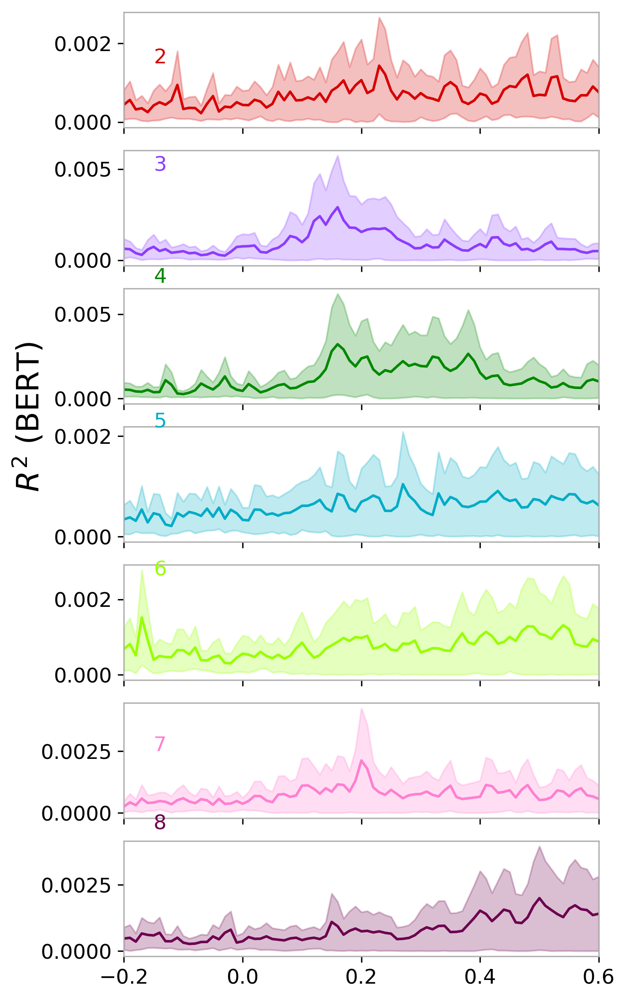

In [83]:
fig, axes = plt.subplots(len(bert_r2s), figsize=(5, 10), sharey=False, sharex=True)

plt.title("$R^2$ (BERT)", rotation="vertical", y=4, x=-0.2)

r2s = []
for i, (sub, values) in enumerate(bert_r2s.items()):
    r2s.append(values)
    max_r2 = np.max(values, axis=0).T
    mu = rms(values).T #, q=.90, axis=0).T
    std = np.std(values, axis=0).T
    t = np.linspace(-0.2, 0.6, values.shape[1])
    #axes[i].plot(t, values.T, color="gray", lw=1)
    #axes[i].plot(t, max_r2, color=cc.glasbey_bw_minc_20[i])
    axes[i].plot(t, mu, color=cc.glasbey_bw_minc_20[i])
    axes[i].fill_between(t, y1=mu-std, y2=mu+std, color=cc.glasbey_bw_minc_20[i], alpha=0.25)
    axes[i].text(-0.15, np.mean(max_r2), sub, color=cc.glasbey_bw_minc_20[i])
plt.show()

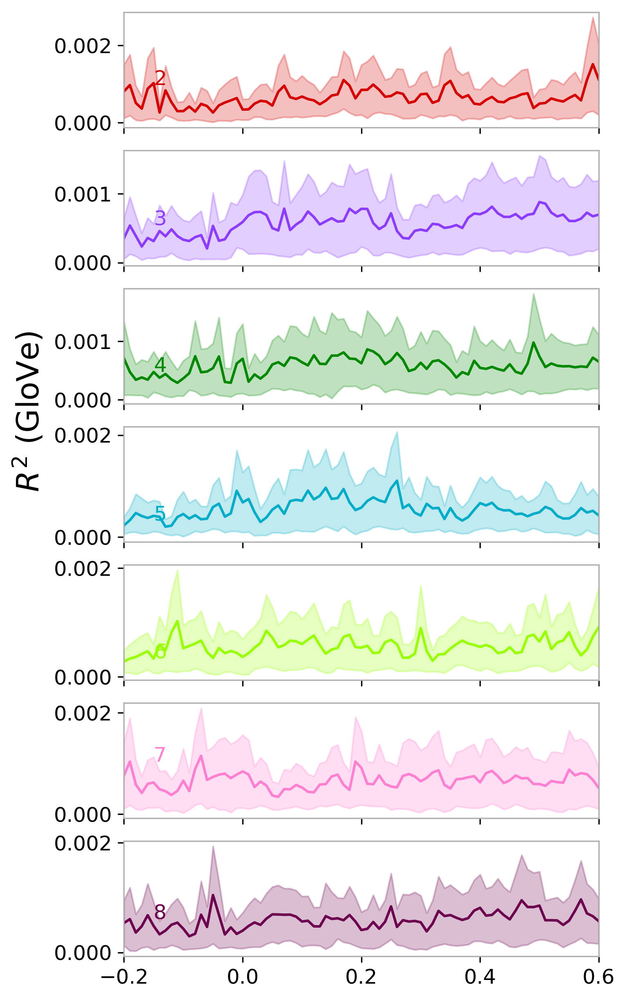

In [86]:
fig, axes = plt.subplots(len(glove_r2s), figsize=(5, 10), sharey=False, sharex=True)

plt.title("$R^2$ (GloVe)", rotation="vertical", y=4, x=-0.2)

r2s = []
for i, (sub, values) in enumerate(glove_r2s.items()):
    r2s.append(values)
    max_r2 = np.max(values, axis=0).T
    mu = rms(values).T #, q=.90, axis=0).T
    std = np.std(values, axis=0).T
    t = np.linspace(-0.2, 0.6, values.shape[1])
    #axes[i].plot(t, values.T, color="gray", lw=1)
    #axes[i].plot(t, max_r2, color=cc.glasbey_bw_minc_20[i])
    axes[i].plot(t, mu, color=cc.glasbey_bw_minc_20[i])
    axes[i].fill_between(t, y1=mu-std, y2=mu+std, color=cc.glasbey_bw_minc_20[i], alpha=0.25)
    axes[i].text(-0.15, mu[1], sub, color=cc.glasbey_bw_minc_20[i])
plt.show()

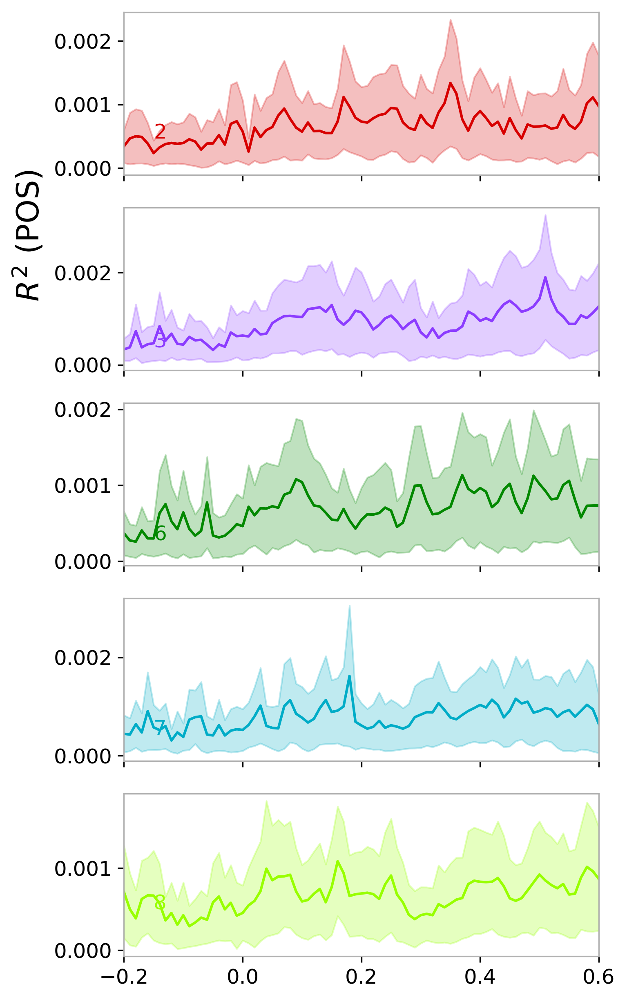

In [87]:
fig, axes = plt.subplots(len(pos_r2s), figsize=(5, 10), sharey=False, sharex=True)

plt.title("$R^2$ (POS)", rotation="vertical", y=4, x=-0.2)

r2s = []
for i, (sub, values) in enumerate(pos_r2s.items()):
    r2s.append(values)
    max_r2 = np.max(values, axis=0).T
    mu = rms(values).T #, q=.90, axis=0).T
    std = np.std(values, axis=0).T
    t = np.linspace(-0.2, 0.6, values.shape[1])
    #axes[i].plot(t, values.T, color="gray", lw=1)
    #axes[i].plot(t, max_r2, color=cc.glasbey_bw_minc_20[i])
    axes[i].plot(t, mu, color=cc.glasbey_bw_minc_20[i])
    axes[i].fill_between(t, y1=mu-std, y2=mu+std, color=cc.glasbey_bw_minc_20[i], alpha=0.25)
    axes[i].text(-0.15, mu[1], sub, color=cc.glasbey_bw_minc_20[i])
plt.show()

No projector specified for this dataset. Please consider the method self.add_proj.


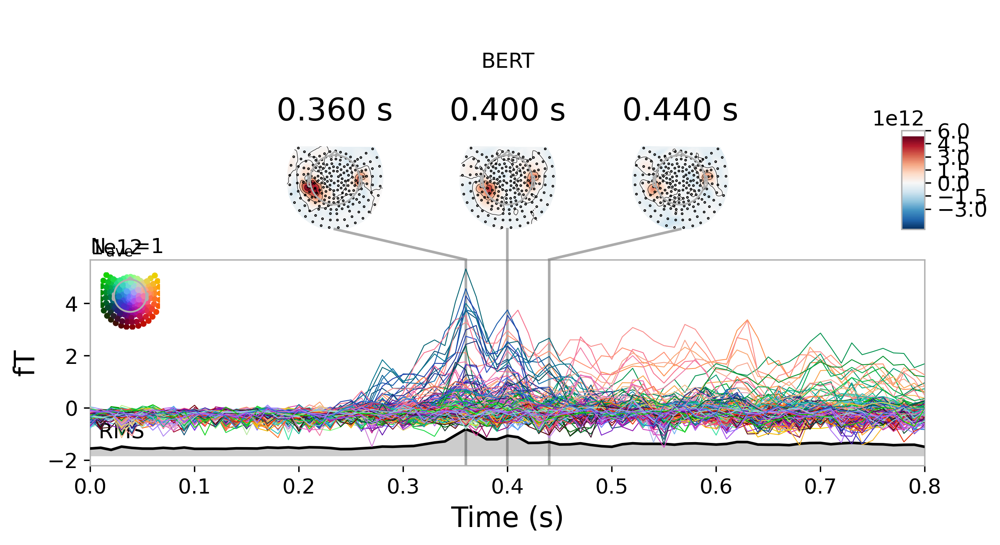

In [90]:
#fig, ax = plt.subplots(1, 1)

r2s = np.array(list(bert_r2s.values()))
evo_r2s_bert = mne.EvokedArray(r2s.mean(axis=0), info)

evo_r2s_bert.plot_joint(title="BERT", picks="meg", ts_args=dict(gfp=True))

# std = np.std(values, axis=0).T
# t = np.linspace(-0.2, 0.6, values.shape[1])
# ax.plot(t,)
plt.show()

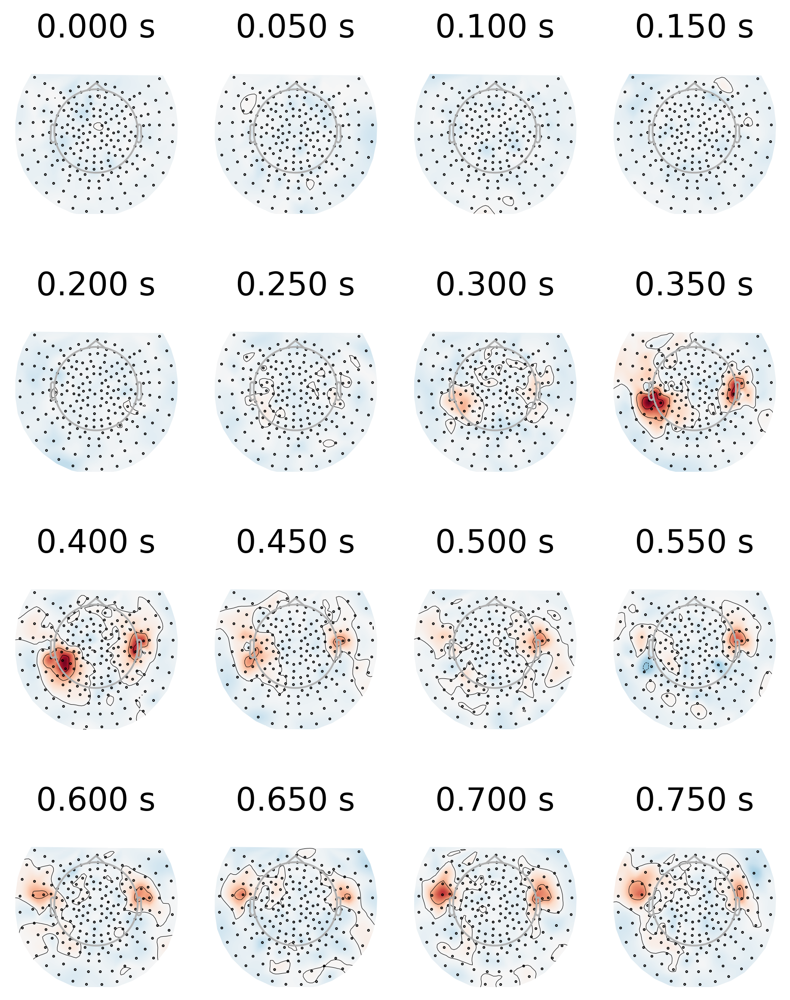

In [106]:
t = np.arange(0.0, 0.8, 0.05)
evo_r2s_bert.plot_topomap(t, ncols=4, nrows=4, colorbar=False)
plt.show()

No projector specified for this dataset. Please consider the method self.add_proj.


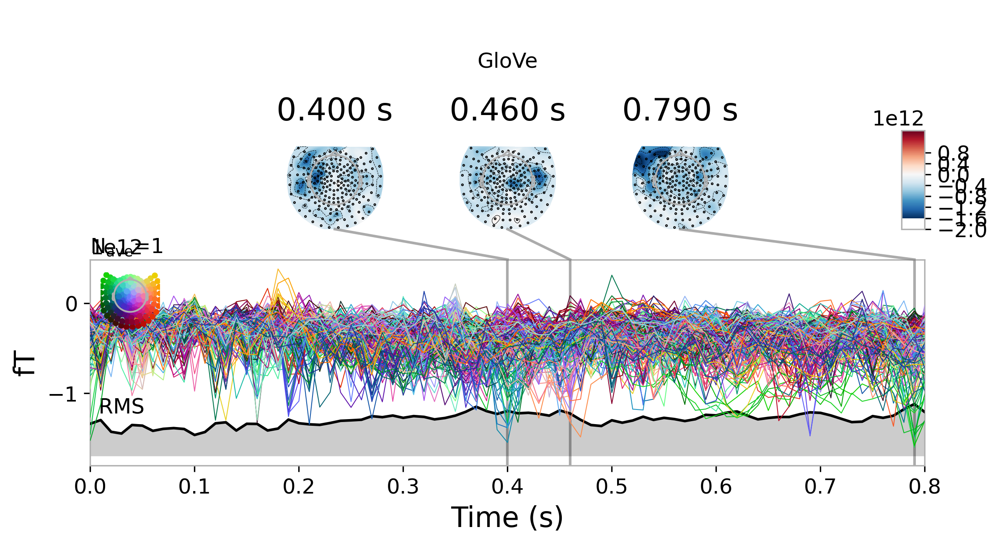

In [92]:
#fig, ax = plt.subplots(1, 1)

r2s = np.array(list(glove_r2s.values()))
evo_r2s_glove = mne.EvokedArray(r2s.mean(axis=0), info)

evo_r2s_glove.plot_joint(title="GloVe", picks="meg", ts_args=dict(gfp=True))

# std = np.std(values, axis=0).T
# t = np.linspace(-0.2, 0.6, values.shape[1])
# ax.plot(t,)
plt.show()

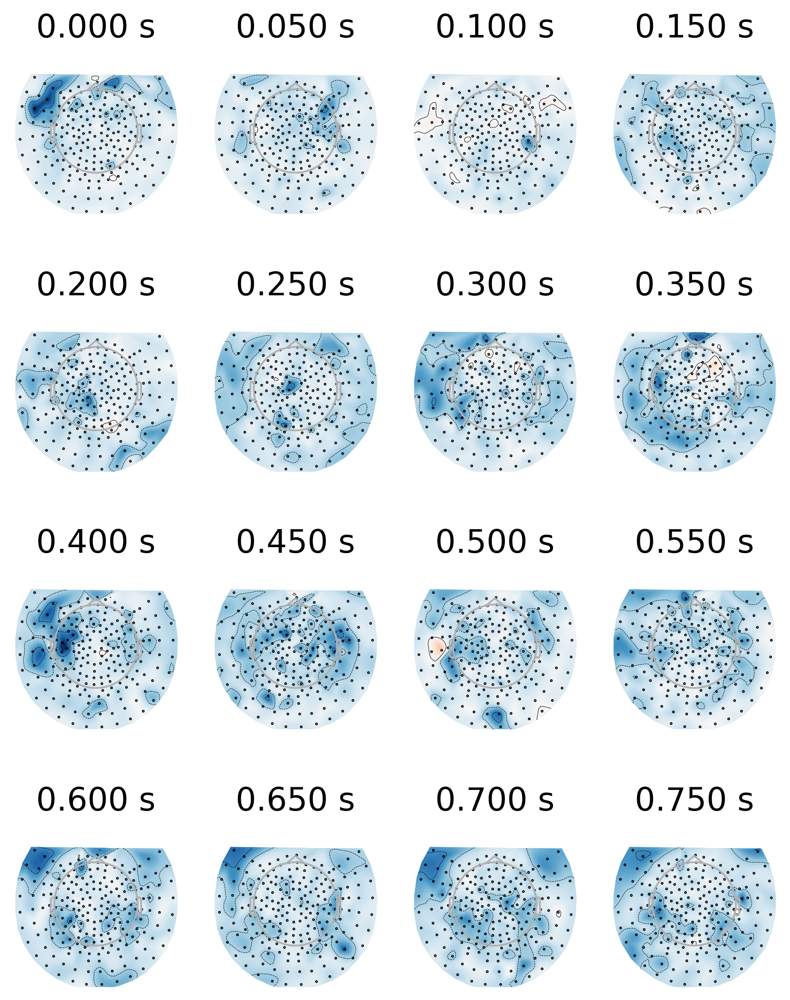

In [107]:
t = np.arange(0.0, 0.8, 0.05)
evo_r2s_glove.plot_topomap(t, ncols=4, nrows=4, colorbar=False)
plt.show()

No projector specified for this dataset. Please consider the method self.add_proj.


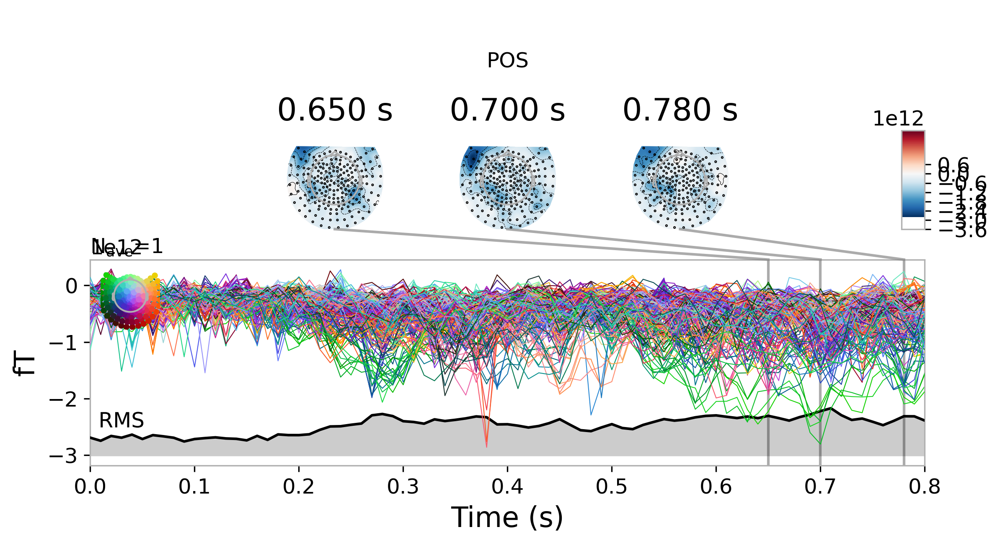

In [93]:
#fig, ax = plt.subplots(1, 1)

r2s = np.array(list(pos_r2s.values()))
evo_r2s_pos = mne.EvokedArray(r2s.mean(axis=0), info)

evo_r2s_pos.plot_joint(title="POS", picks="meg", ts_args=dict(gfp=True))

# std = np.std(values, axis=0).T
# t = np.linspace(-0.2, 0.6, values.shape[1])
# ax.plot(t,)
plt.show()

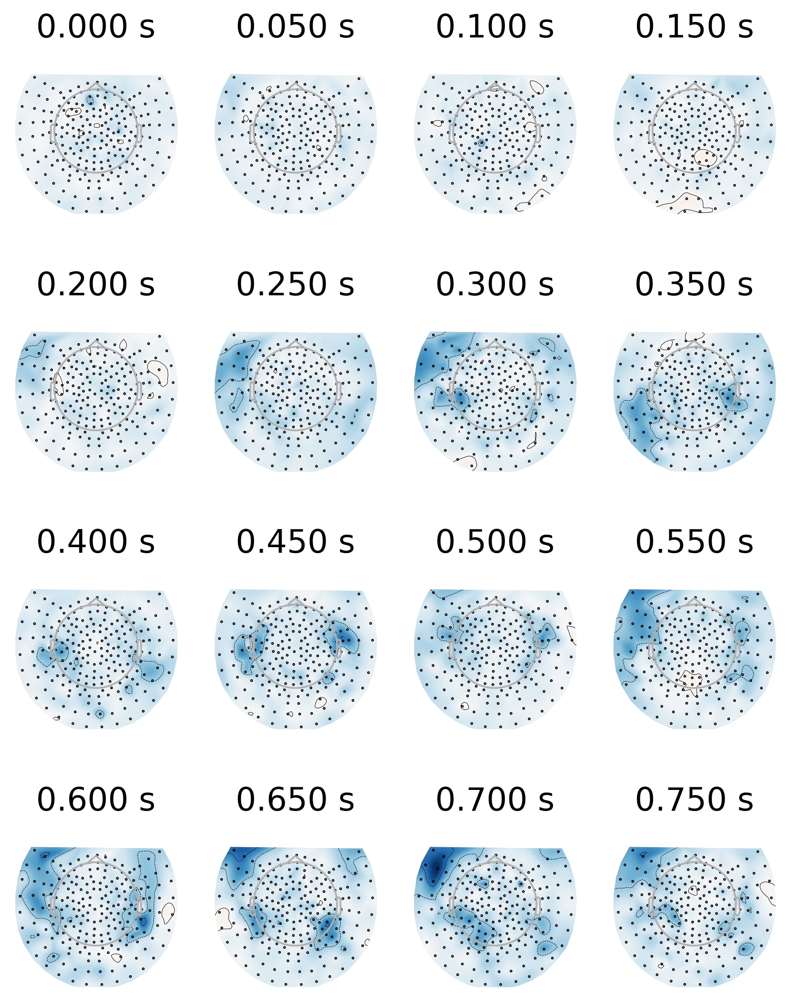

In [108]:
t = np.arange(0.0, 0.8, 0.05)
evo_r2s_pos.plot_topomap(t, ncols=4, nrows=4, colorbar=False)
plt.show()

## Pearson line plots

In [36]:
all_corr_bert = load_results(
    exp="bert",
    kind="corr",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

all_corr_glove = load_results(
    exp="glove",
    kind="corr",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)


all_corr_pos = load_results(
    exp="postag",
    kind="corr",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

100%|███████████████████████████████████████████| 5/5 [00:00<00:00, 3797.81it/s]


In [72]:
all_corr_bert = {k: v.reshape(-1, 2).T.reshape(-1, nchan, ntime) for k, v in all_corr_bert.items()}
all_corr_glove = {k: v.reshape(-1, 2).T.reshape(-1, nchan, ntime) for k, v in all_corr_glove.items()}
all_corr_pos = {k: v.reshape(-1, 2).T.reshape(-1, nchan, ntime) for k, v in all_corr_pos.items()}

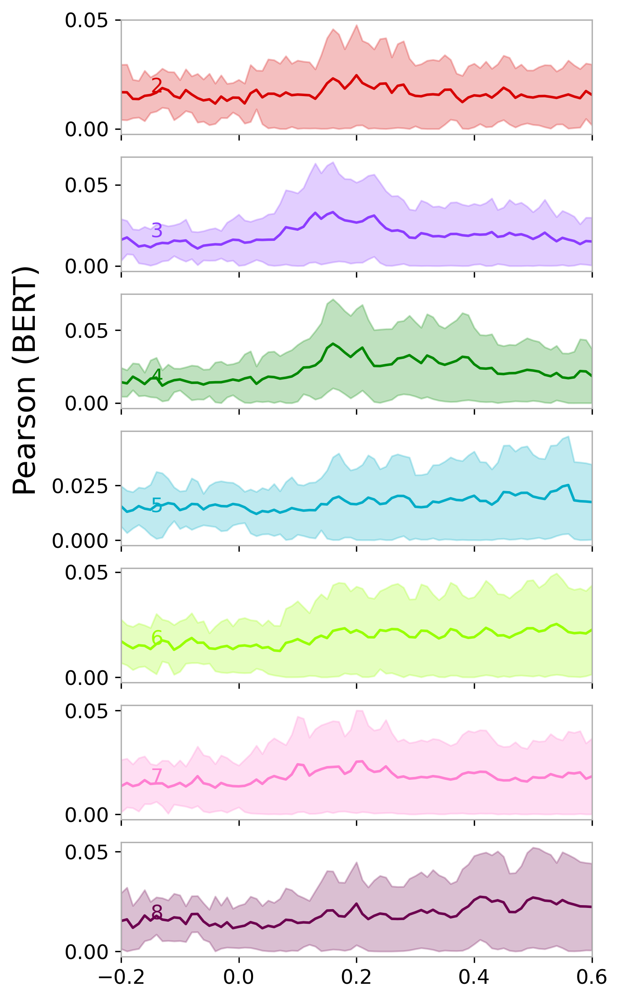

In [111]:
fig, axes = plt.subplots(len(all_corr_bert), figsize=(5, 10), sharey=False, sharex=True)

plt.title("Pearson (BERT)", rotation="vertical", y=4, x=-0.2)

corr = []
for i, (sub, values) in enumerate(all_corr_bert.items()):
    v = values[0, :]
    corr.append(v)
    max_r2 = np.max(v, axis=0).T
    mu = rms(v).T #, q=.90, axis=0).T
    std = np.std(v, axis=0).T
    t = np.linspace(-0.2, 0.6, v.shape[1])
    #axes[i].plot(t, values.T, color="gray", lw=1)
    #axes[i].plot(t, max_r2, color=cc.glasbey_bw_minc_20[i])
    axes[i].plot(t, mu, color=cc.glasbey_bw_minc_20[i])
    axes[i].fill_between(t, y1=mu-std, y2=mu+std, color=cc.glasbey_bw_minc_20[i], alpha=0.25)
    axes[i].text(-0.15, mu[1], sub, color=cc.glasbey_bw_minc_20[i])
plt.show()

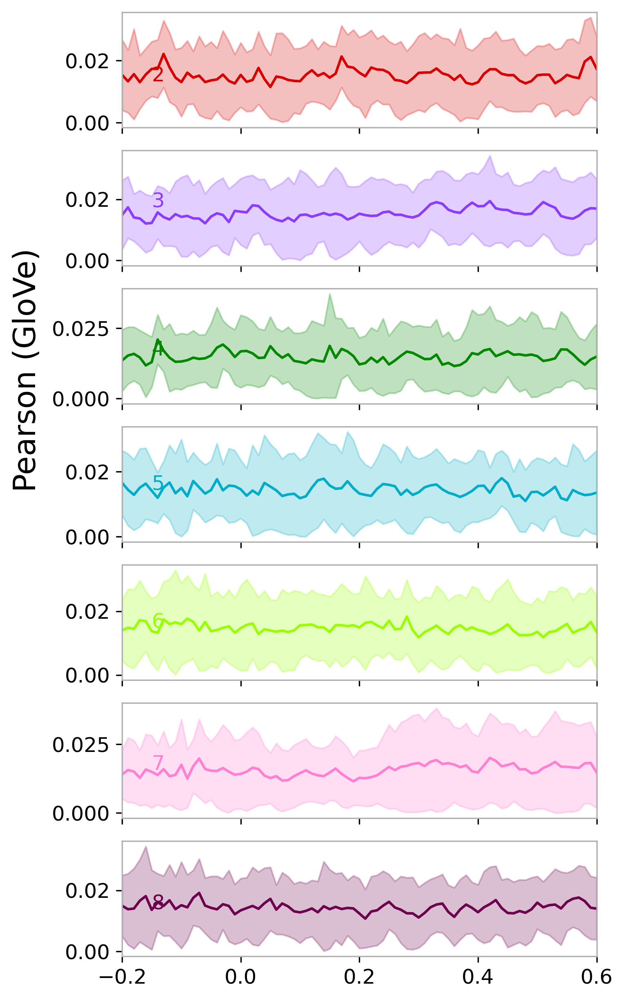

In [112]:
fig, axes = plt.subplots(len(all_corr_glove), figsize=(5, 10), sharey=False, sharex=True)

plt.title("Pearson (GloVe)", rotation="vertical", y=4, x=-0.2)

corr = []
for i, (sub, values) in enumerate(all_corr_glove.items()):
    v = values[0, :]
    corr.append(v)
    max_r2 = np.max(v, axis=0).T
    mu = rms(v).T #, q=.90, axis=0).T
    std = np.std(v, axis=0).T
    t = np.linspace(-0.2, 0.6, v.shape[1])
    #axes[i].plot(t, values.T, color="gray", lw=1)
    #axes[i].plot(t, max_r2, color=cc.glasbey_bw_minc_20[i])
    axes[i].plot(t, mu, color=cc.glasbey_bw_minc_20[i])
    axes[i].fill_between(t, y1=mu-std, y2=mu+std, color=cc.glasbey_bw_minc_20[i], alpha=0.25)
    axes[i].text(-0.15, mu[1], sub, color=cc.glasbey_bw_minc_20[i])
plt.show()

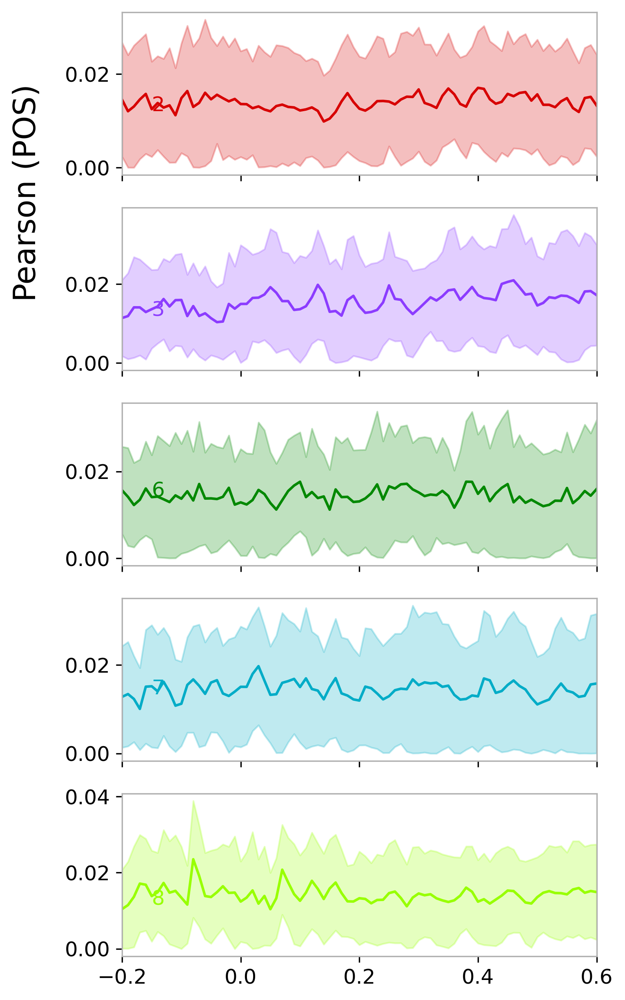

In [113]:
fig, axes = plt.subplots(len(all_corr_pos), figsize=(5, 10), sharey=False, sharex=True)

plt.title("Pearson (POS)", rotation="vertical", y=4, x=-0.2)

corr = []
for i, (sub, values) in enumerate(all_corr_pos.items()):
    v = values[0, :]
    corr.append(v)
    max_r2 = np.max(v, axis=0).T
    mu = rms(v).T #, q=.90, axis=0).T
    std = np.std(v, axis=0).T
    t = np.linspace(-0.2, 0.6, v.shape[1])
    #axes[i].plot(t, values.T, color="gray", lw=1)
    #axes[i].plot(t, max_r2, color=cc.glasbey_bw_minc_20[i])
    axes[i].plot(t, mu, color=cc.glasbey_bw_minc_20[i])
    axes[i].fill_between(t, y1=mu-std, y2=mu+std, color=cc.glasbey_bw_minc_20[i], alpha=0.25)
    axes[i].text(-0.15, mu[1], sub, color=cc.glasbey_bw_minc_20[i])
plt.show()

No projector specified for this dataset. Please consider the method self.add_proj.


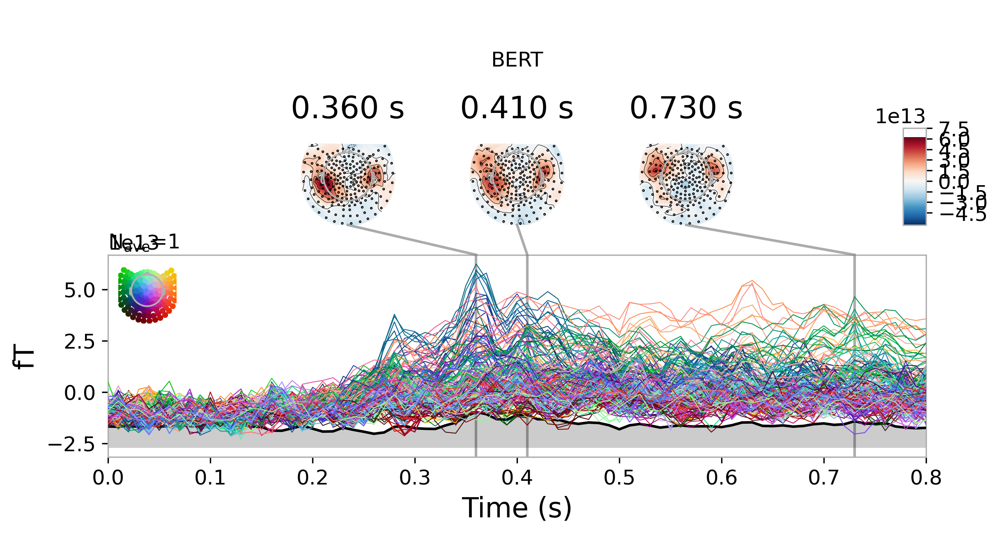

In [120]:
#fig, ax = plt.subplots(1, 1)

corr = np.array(list(all_corr_bert.values()))[:, 0, :]
evo_corr_bert = mne.EvokedArray(corr.mean(axis=0), info)

evo_corr_bert.plot_joint(title="BERT", picks="meg", ts_args=dict(gfp=True))

# std = np.std(values, axis=0).T
# t = np.linspace(-0.2, 0.6, values.shape[1])
# ax.plot(t,)
plt.show()

No projector specified for this dataset. Please consider the method self.add_proj.


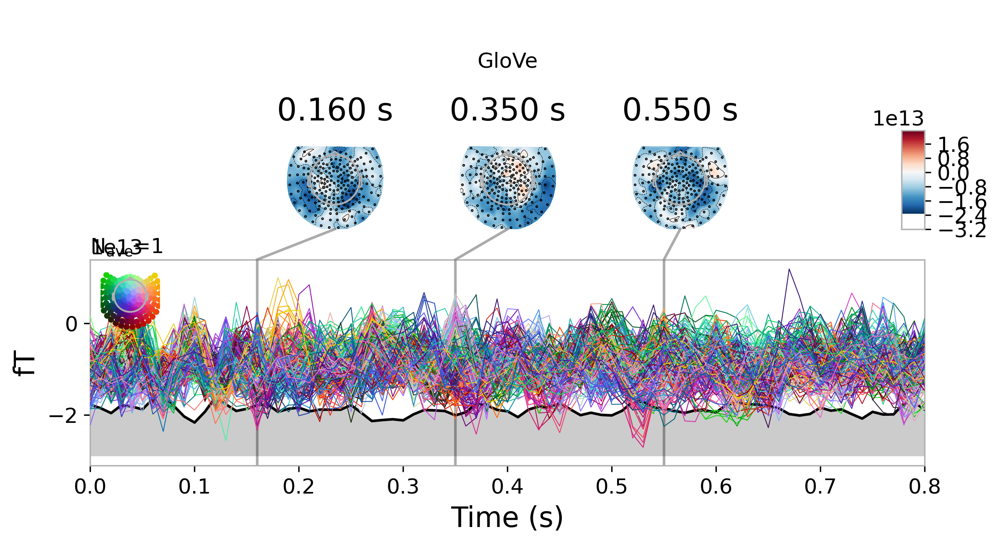

In [122]:
#fig, ax = plt.subplots(1, 1)

corr = np.array(list(all_corr_glove.values()))[:, 0, :]
evo_corr_glove = mne.EvokedArray(corr.mean(axis=0), info)

evo_corr_glove.plot_joint(title="GloVe", picks="meg", ts_args=dict(gfp=True))

# std = np.std(values, axis=0).T
# t = np.linspace(-0.2, 0.6, values.shape[1])
# ax.plot(t,)
plt.show()

No projector specified for this dataset. Please consider the method self.add_proj.


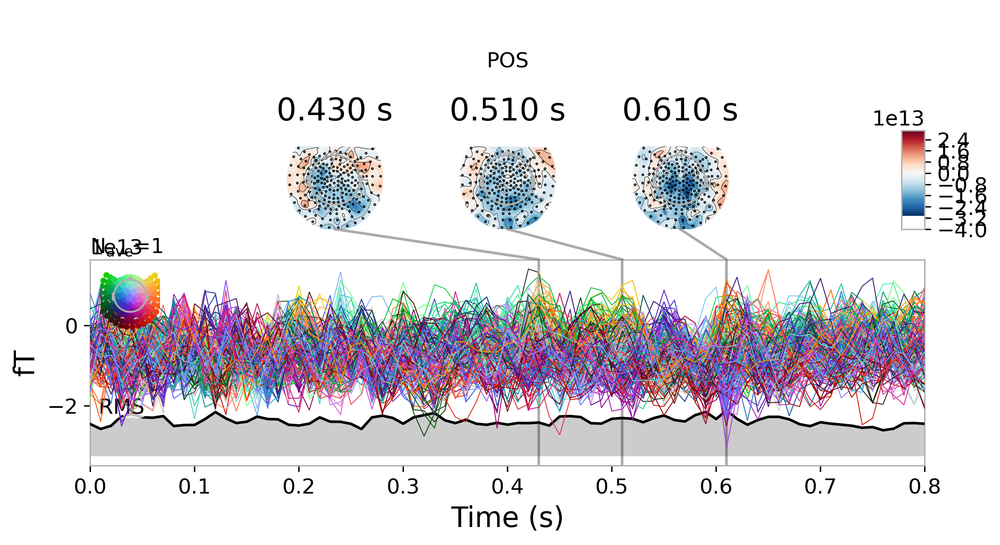

In [124]:
#fig, ax = plt.subplots(1, 1)

corr = np.array(list(all_corr_pos.values()))[:, 0, :]
evo_corr_pos = mne.EvokedArray(corr.mean(axis=0), info)

evo_corr_pos.plot_joint(title="POS", picks="meg", ts_args=dict(gfp=True))

# std = np.std(values, axis=0).T
# t = np.linspace(-0.2, 0.6, values.shape[1])
# ax.plot(t,)
plt.show()

## Predictions

In [8]:
all_bert_preds = load_results(
    exp="bert",
    kind="pred",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

bert_evo, = as_evoked(all_bert_preds, concat=True)

['meg_sub2_predictions\\bert_s0_predictions', 'meg_sub3_predictions\\bert_s0_predictions', 'meg_sub4_predictions\\bert_s0_predictions', 'meg_sub5_predictions\\bert_s0_predictions', 'meg_sub6_predictions\\bert_s0_predictions', 'meg_sub7_predictions\\bert_s0_predictions', 'meg_sub8_predictions\\bert_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [02:11<00:00, 18.75s/it]


Not setting metadata
59927 matching events found
No baseline correction applied
0 projection items activated


In [8]:
all_glove_preds = load_results(
    exp="glove",
    kind="pred",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

glove_evo, = as_evoked(all_glove_preds, concat=True)

['meg_sub2_predictions\\glove_s0_predictions', 'meg_sub3_predictions\\glove_s0_predictions', 'meg_sub4_predictions\\glove_s0_predictions', 'meg_sub5_predictions\\glove_s0_predictions', 'meg_sub6_predictions\\glove_s0_predictions', 'meg_sub7_predictions\\glove_s0_predictions', 'meg_sub8_predictions\\glove_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [02:17<00:00, 19.67s/it]


Not setting metadata
59927 matching events found
No baseline correction applied
0 projection items activated


In [16]:
all_pos_preds = load_results(
    exp="postag",
    kind="pred",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

pos_evo, = as_evoked(all_pos_preds, concat=True)

['meg_sub2_predictions\\postag_s0_predictions', 'meg_sub3_predictions\\postag_s0_predictions', 'meg_sub4_predictions\\postag_s0_predictions', 'meg_sub5_predictions\\postag_s0_predictions', 'meg_sub6_predictions\\postag_s0_predictions', 'meg_sub7_predictions\\postag_s0_predictions', 'meg_sub8_predictions\\postag_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [02:15<00:00, 19.42s/it]


Not setting metadata
59927 matching events found
No baseline correction applied
0 projection items activated


In [13]:
all_dep_preds = load_results(
    exp="deptag",
    kind="pred",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

dep_evo, = as_evoked(all_dep_preds, concat=True)

['meg_sub2_predictions\\deptags_s0_predictions', 'meg_sub3_predictions\\deptags_s0_predictions', 'meg_sub4_predictions\\deptag_s0_predictions', 'meg_sub5_predictions\\deptag_s0_predictions', 'meg_sub6_predictions\\deptags_s0_predictions', 'meg_sub7_predictions\\deptags_s0_predictions', 'meg_sub8_predictions\\deptags_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [03:47<00:00, 32.51s/it]


Not setting metadata
59927 matching events found
No baseline correction applied
0 projection items activated


In [8]:
all_cm_preds = load_results(
    exp="cm",
    kind="pred",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

cm_evo, = as_evoked(all_cm_preds, concat=True)

['meg_sub2_predictions\\cm_s0_predictions', 'meg_sub3_predictions\\cm_s0_predictions', 'meg_sub4_predictions\\cm_s0_predictions', 'meg_sub5_predictions\\cm_s0_predictions', 'meg_sub6_predictions\\cm_s0_predictions', 'meg_sub7_predictions\\cm_s0_predictions', 'meg_sub8_predictions\\cm_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [03:13<00:00, 27.62s/it]


Not setting metadata
59927 matching events found
No baseline correction applied
0 projection items activated


In [9]:
ground_truth = load_results(
    exp="bert",
    kind="test",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

ground_evo, = as_evoked(ground_truth, concat=True)

['meg_sub2_predictions\\bert_s0_predictions', 'meg_sub3_predictions\\bert_s0_predictions', 'meg_sub4_predictions\\bert_s0_predictions', 'meg_sub5_predictions\\bert_s0_predictions', 'meg_sub6_predictions\\bert_s0_predictions', 'meg_sub7_predictions\\bert_s0_predictions', 'meg_sub8_predictions\\bert_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [02:10<00:00, 18.63s/it]


Not setting metadata
59927 matching events found
No baseline correction applied
0 projection items activated


In [211]:
import pickle

names = ["BERT", "GloVe", "POS"]
for i, evo in enumerate([bert_evo, glove_evo, pos_evo]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

In [9]:
import pickle

names = ["POS"]
for i, evo in enumerate([pos_evo]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

In [11]:
import pickle

with open("BERT", "rb") as fp:
    bert_evo = pickle.load(fp)
    

with open("GloVe", "rb") as fp:
    glove_evo = pickle.load(fp)
    

with open("POS", "rb") as fp:
    pos_evo = pickle.load(fp)
    
with open("DEP", "rb") as fp:
    dep_evo = pickle.load(fp)
    
with open("CM", "rb") as fp:
    cm_evo = pickle.load(fp)
    
with open("ground", "rb") as fp:
    ground_evo = pickle.load(fp)

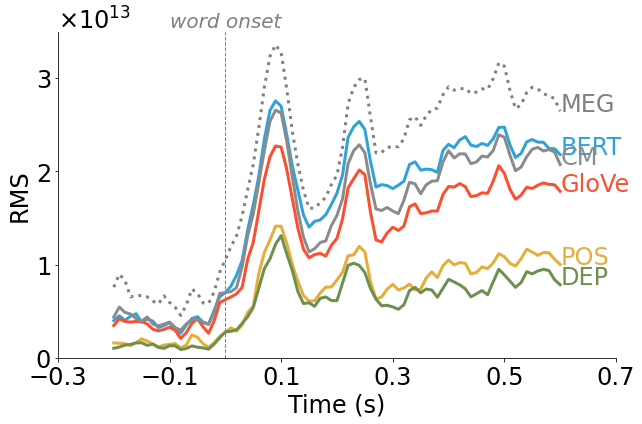

In [38]:
import matplotlib

plt.figure(figsize=(10, 6))
plt.rcParams.update({'font.size': 18})
plt.ylim(0.0, 3.5*1e13)
t = np.linspace(-0.2, 0.6, ntime)
names = ["BERT", "GloVe", "POS", "DEP", "CM", "MEG"]
for i, evo in enumerate([bert_evo, glove_evo, pos_evo, dep_evo, cm_evo, ground_evo]):
    x = rms(evo.get_data() * 1e15) # coef is from MNE
    color = cc.glasbey_hv[i] if names[i] != "MEG" else "gray"
    style = None if names[i] != "MEG" else ":"
    plt.plot(t, x, color=color, linestyle=style, lw=3)
    idx = 80
    plt.text(idx/100 - 0.2, x[idx], names[i], color=color, size=24)
    
plt.vlines(0.0, 0.0, 3.5e13, linestyle='--', lw=1, color="gray")

plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)

mf = matplotlib.ticker.ScalarFormatter(useMathText=True)
mf.set_powerlimits((-2,2))
plt.gca().yaxis.set_major_formatter(mf)
plt.gca().yaxis.get_offset_text().set_size(24)

plt.xticks(plt.xticks()[0][::2], size=24)
plt.yticks(plt.yticks()[0][::2], size=24)

plt.ylabel("RMS", size=24)
plt.xlabel("Time (s)", size=24)

plt.text(0.0, 3.55*1e13, "word onset", size=20, color="gray", fontstyle="italic", ha="center")

for ext in ["pdf", "svg", "png"]:
    plt.savefig(f"./pred_rms.{ext}", bbox_inches="tight")

plt.show()

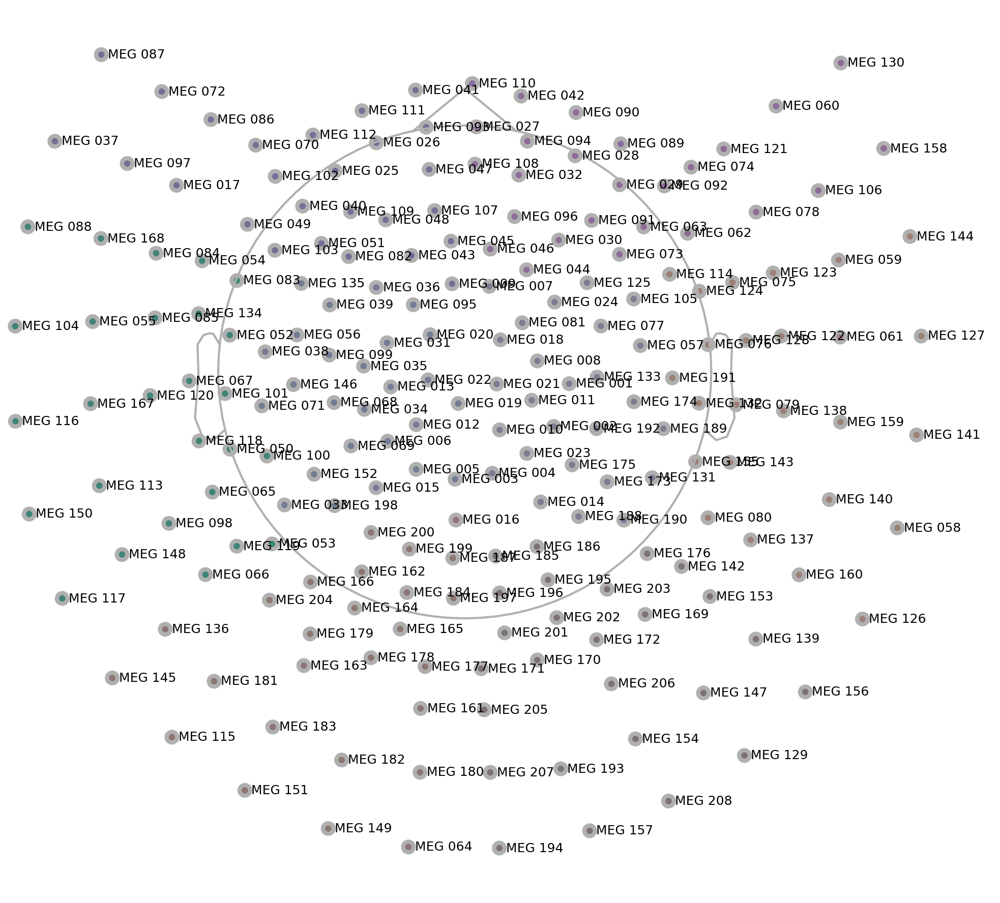

In [141]:
plt.rcParams.update({'font.size': 6})
pos_evo.plot_sensors(ch_groups="position", show_names=True)
plt.show()

In [19]:
parietal_l = ["MEG " + str(i).zfill(3) for i in np.unique([65, 119, 204, 166, 53, 200, 33, 198,152, 100, 69, 5, 3, 6, 12, 34])]
temporal_l = ["MEG " + str(i).zfill(3) for i in np.unique([87, 72, 86, 70, 37, 97, 17, 88, 168, 84, 104, 55, 85])]

In [24]:
files = sorted(glob.glob(f"meg_sub*/bert*"))

In [17]:
def as_evoked_tags(*data, nindices, concat=False):
    evoked = []
    for datum in data:
        if concat:
            pred_epochs = np.concatenate(list(datum.values()))
            evoked.append(mne.EpochsArray(pred_epochs[nindices], info).average())
        else:
            pred_epochs = dict()
            for sub, preds in datum.items():
                pred_epochs[sub] = mne.EpochsArray(preds[nindices], info).average()
            evoked.append(pred_epochs)
    return tuple(evoked)

In [72]:
all_pos_preds = load_results(
    exp="postag",
    kind="pred",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

['meg_sub2_predictions\\postag_s0_predictions', 'meg_sub3_predictions\\postag_s0_predictions', 'meg_sub4_predictions\\postag_s0_predictions', 'meg_sub5_predictions\\postag_s0_predictions', 'meg_sub6_predictions\\postag_s0_predictions', 'meg_sub7_predictions\\postag_s0_predictions', 'meg_sub8_predictions\\postag_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [02:11<00:00, 18.83s/it]


In [76]:
nouns_evo = as_evoked_tags(all_pos_preds, nindices = nouns_indices, concat=False)

Not setting metadata
1771 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1771 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1771 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1771 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1771 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1771 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1771 matching events found
No baseline correction applied
0 projection items activated


In [84]:
nouns_pred_avg = mne.combine_evoked([nouns_evo[0]['meg_sub2_predictions'], nouns_evo[0]['meg_sub3_predictions'], nouns_evo[0]['meg_sub4_predictions'], nouns_evo[0]['meg_sub5_predictions'],
                                   nouns_evo[0]['meg_sub6_predictions'], nouns_evo[0]['meg_sub7_predictions'], nouns_evo[0]['meg_sub8_predictions']], weights='nave')

In [87]:
import pickle

names = ["Noun"]
for i, evo in enumerate([nouns_pred_avg]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

In [18]:
verb_evo = as_evoked_tags(all_pos_preds, nindices = verb_indices, concat=False)
verb_pred_avg = mne.combine_evoked([verb_evo[0]['meg_sub2_predictions'], verb_evo[0]['meg_sub3_predictions'], verb_evo[0]['meg_sub4_predictions'], verb_evo[0]['meg_sub5_predictions'],
                                   verb_evo[0]['meg_sub6_predictions'], verb_evo[0]['meg_sub7_predictions'], verb_evo[0]['meg_sub8_predictions']], weights='nave')

Not setting metadata
1701 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1701 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1701 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1701 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1701 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1701 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1701 matching events found
No baseline correction applied
0 projection items activated


In [19]:
import pickle

names = ["Verb"]
for i, evo in enumerate([verb_pred_avg]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

In [20]:
adj_evo = as_evoked_tags(all_pos_preds, nindices = adj_indices, concat=False)
adj_pred_avg = mne.combine_evoked([adj_evo[0]['meg_sub2_predictions'], adj_evo[0]['meg_sub3_predictions'], adj_evo[0]['meg_sub4_predictions'], adj_evo[0]['meg_sub5_predictions'],
                                   adj_evo[0]['meg_sub6_predictions'], adj_evo[0]['meg_sub7_predictions'], adj_evo[0]['meg_sub8_predictions']], weights='nave')

names = ["Adjective"]
for i, evo in enumerate([adj_pred_avg]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

Not setting metadata
690 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
690 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
690 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
690 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
690 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
690 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
690 matching events found
No baseline correction applied
0 projection items activated


In [21]:
adv_evo = as_evoked_tags(all_pos_preds, nindices = adv_indices, concat=False)
adv_pred_avg = mne.combine_evoked([adv_evo[0]['meg_sub2_predictions'], adv_evo[0]['meg_sub3_predictions'], adv_evo[0]['meg_sub4_predictions'], adv_evo[0]['meg_sub5_predictions'],
                                   adv_evo[0]['meg_sub6_predictions'], adv_evo[0]['meg_sub7_predictions'], adv_evo[0]['meg_sub8_predictions']], weights='nave')

names = ["adverb"]
for i, evo in enumerate([adv_pred_avg]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

Not setting metadata
562 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
562 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
562 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
562 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
562 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
562 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
562 matching events found
No baseline correction applied
0 projection items activated


In [17]:
import pickle

with open("Noun", "rb") as fp:
    noun_evo = pickle.load(fp)
    

with open("Verb", "rb") as fp:
    verb_evo = pickle.load(fp)
    

with open("Adjective", "rb") as fp:
    adj_evo = pickle.load(fp)
    
with open("adverb", "rb") as fp:
    adv_evo = pickle.load(fp)
    
with open("Subj", "rb") as fp:
    subj_evo = pickle.load(fp)
    
with open("Obj", "rb") as fp:
    obj_evo = pickle.load(fp)
    
with open("ground", "rb") as fp:
    ground_evo = pickle.load(fp)

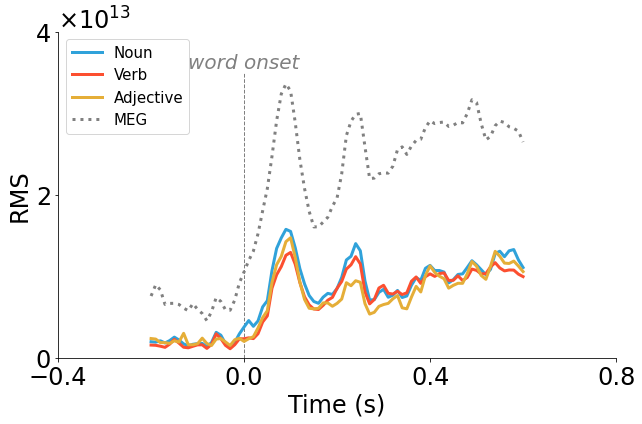

In [37]:
import matplotlib

plt.figure(figsize=(10, 6))
plt.rcParams.update({'font.size': 24})
plt.ylim(0.0, 3.5*1e13)
t = np.linspace(-0.2, 0.6, ntime)
names = ["Noun", "Verb", "Adjective", "MEG"]
for i, evo in enumerate([noun_evo, verb_evo, adj_evo, ground_evo]):
    x = rms(evo.get_data() * 1e15) # coef is from MNE
    color = cc.glasbey_hv[i] if names[i] != "MEG" else "gray"
    style = None if names[i] != "MEG" else ":"
    plt.plot(t, x, color=color, linestyle=style, lw=3)
    idx = 80
    #plt.text(idx/100 - 0.2, x[idx], names[i], color=color, size=14)
    
plt.vlines(0.0, 0.0, 3.5e13, linestyle='--', lw=1, color="gray")

plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)

mf = matplotlib.ticker.ScalarFormatter(useMathText=True)
mf.set_powerlimits((-2,2))
plt.gca().yaxis.set_major_formatter(mf)
plt.gca().yaxis.get_offset_text().set_size(24)

plt.xticks(plt.xticks()[0][::2], size=24)
plt.yticks(plt.yticks()[0][::2], size=24)

plt.ylabel("RMS", size=24)
plt.xlabel("Time (s)", size=24)
plt.legend(["Noun", "Verb", "Adjective", "MEG"], fontsize=15)

plt.text(0.0, 3.55*1e13, "word onset", size=20, color="gray", fontstyle="italic", ha="center")

for ext in ["pdf", "svg", "png"]:
    plt.savefig(f"./pred_postags_rms.{ext}", bbox_inches="tight")

plt.show()

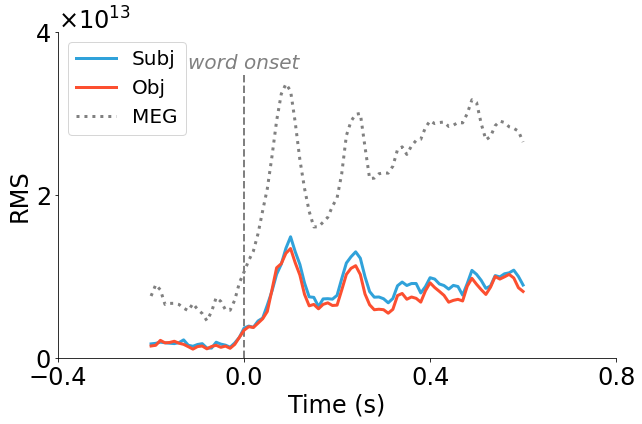

In [30]:
import matplotlib

plt.figure(figsize=(10, 6))
plt.rcParams.update({'font.size': 24})
plt.ylim(0.0, 3.5*1e13)
t = np.linspace(-0.2, 0.6, ntime)
names = [ "Subj", "Obj", "MEG"]
for i, evo in enumerate([ subj_evo, obj_evo, ground_evo]):
    x = rms(evo.get_data() * 1e15) # coef is from MNE
    color = cc.glasbey_hv[i] if names[i] != "MEG" else "gray"
    style = None if names[i] != "MEG" else ":"
    plt.plot(t, x, color=color, linestyle=style, lw=3)
    idx = 80
    #plt.text(idx/100 - 0.2, x[idx], names[i], color=color, size=14)
    
plt.vlines(0.0, 0.0, 3.5e13, linestyle='--', lw=2, color="gray")

plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)

mf = matplotlib.ticker.ScalarFormatter(useMathText=True)
mf.set_powerlimits((-2,2))
plt.gca().yaxis.set_major_formatter(mf)
plt.gca().yaxis.get_offset_text().set_size(24)

plt.xticks(plt.xticks()[0][::2], size=24)
plt.yticks(plt.yticks()[0][::2], size=24)

plt.ylabel("RMS", size=24)
plt.xlabel("Time (s)", size=24)
plt.legend(["Subj", "Obj", "MEG"], fontsize=20)

plt.text(0.0, 3.55*1e13, "word onset", size=20, color="gray", fontstyle="italic", ha="center")

for ext in ["pdf", "svg", "png"]:
    plt.savefig(f"./pred_deptags_rms.{ext}", bbox_inches="tight")

plt.show()

In [15]:
subj_evo = as_evoked_tags(all_dep_preds, nindices = subj_indices, concat=False)
subj_pred_avg = mne.combine_evoked([subj_evo[0]['meg_sub2_predictions'], subj_evo[0]['meg_sub3_predictions'], subj_evo[0]['meg_sub4_predictions'], subj_evo[0]['meg_sub5_predictions'],
                                   subj_evo[0]['meg_sub6_predictions'], subj_evo[0]['meg_sub7_predictions'], subj_evo[0]['meg_sub8_predictions']], weights='nave')

obj_evo = as_evoked_tags(all_dep_preds, nindices = obj_indices, concat=False)
obj_pred_avg = mne.combine_evoked([obj_evo[0]['meg_sub2_predictions'], obj_evo[0]['meg_sub3_predictions'], obj_evo[0]['meg_sub4_predictions'], obj_evo[0]['meg_sub5_predictions'],
                                   obj_evo[0]['meg_sub6_predictions'], obj_evo[0]['meg_sub7_predictions'], obj_evo[0]['meg_sub8_predictions']], weights='nave')

Not setting metadata
958 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
958 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
958 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
958 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
958 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
958 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
958 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1415 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1415 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
1415 matching 

In [16]:
import pickle

names = ["Subj", "Obj"]
for i, evo in enumerate([subj_pred_avg, obj_pred_avg]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

NameError: name 'subj_pred_avg' is not defined

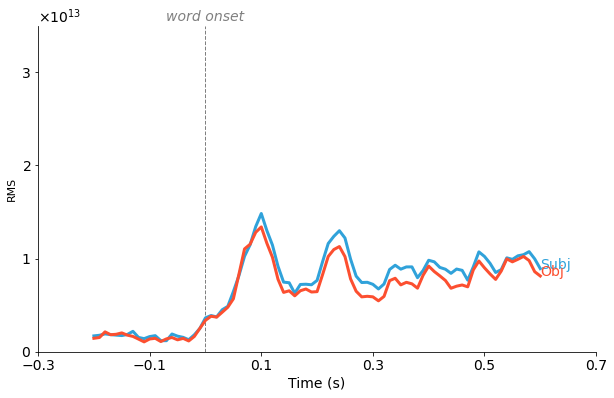

In [17]:
import matplotlib

plt.figure(figsize=(10, 6))
plt.rcParams.update({'font.size': 14})
plt.ylim(0.0, 3.5*1e13)
t = np.linspace(-0.2, 0.6, ntime)
names = ["Subj", "Obj"]
for i, evo in enumerate([subj_pred_avg, obj_pred_avg]):
    x = rms(evo.get_data() * 1e15) # coef is from MNE
    color = cc.glasbey_hv[i] if names[i] != "MEG" else "gray"
    style = None if names[i] != "MEG" else ":"
    plt.plot(t, x, color=color, linestyle=style, lw=3)
    idx = 80
    plt.text(idx/100 - 0.2, x[idx], names[i], color=color, size=14)
    
plt.vlines(0.0, 0.0, 3.5e13, linestyle='--', lw=1, color="gray")

plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)

mf = matplotlib.ticker.ScalarFormatter(useMathText=True)
mf.set_powerlimits((-2,2))
plt.gca().yaxis.set_major_formatter(mf)
plt.gca().yaxis.get_offset_text().set_size(14)

plt.xticks(plt.xticks()[0][::2], size=14)
plt.yticks(plt.yticks()[0][::2], size=14)

plt.ylabel("RMS", size=11)
plt.xlabel("Time (s)", size=14)

plt.text(0.0, 3.55*1e13, "word onset", size=14, color="gray", fontstyle="italic", ha="center")

for ext in ["pdf", "svg", "png"]:
    plt.savefig(f"./pred_deptags_rms.{ext}", bbox_inches="tight")

plt.show()

In [8]:
all_bert_preds_seq = load_results(
    exp="bertseq",
    kind="pred",
    info=info,
    nchan=nchan, 
    ntime=ntime, 
    concat=False
)

bert_seq_evo, = as_evoked(all_bert_preds_seq, concat=True)

['meg_sub2_predictions\\bertseq1_s0_predictions', 'meg_sub3_predictions\\bertseq1_s0_predictions', 'meg_sub4_predictions\\bertseq1_s0_predictions', 'meg_sub5_predictions\\bertseq1_s0_predictions', 'meg_sub6_predictions\\bertseq1_s0_predictions', 'meg_sub7_predictions\\bertseq1_s0_predictions', 'meg_sub8_predictions\\bertseq1_s0_predictions']


100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [01:01<00:00,  8.83s/it]


Not setting metadata
59927 matching events found
No baseline correction applied
0 projection items activated


In [10]:
import pickle

names = ["BERT_SEQ"]
for i, evo in enumerate([bert_seq_evo]):
    with open(names[i], "wb+") as fp:
        pickle.dump(evo, fp)

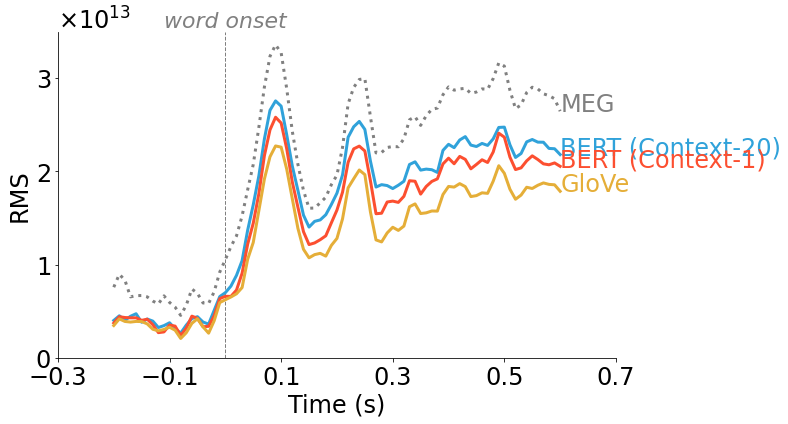

In [31]:
import matplotlib

plt.figure(figsize=(10, 6))
plt.rcParams.update({'font.size': 14})
plt.ylim(0.0, 3.5*1e13)
t = np.linspace(-0.2, 0.6, ntime)
names = ["BERT (Context-20)", "BERT (Context-1)", "GloVe", "MEG"]
for i, evo in enumerate([bert_evo, bert_seq_evo, glove_evo, ground_evo]):
    x = rms(evo.get_data() * 1e15) # coef is from MNE
    color = cc.glasbey_hv[i] if names[i] != "MEG" else "gray"
    style = None if names[i] != "MEG" else ":"
    plt.plot(t, x, color=color, linestyle=style, lw=3)
    idx = 80
    plt.text(idx/100 - 0.2, x[idx], names[i], color=color, size=24)
    
plt.vlines(0.0, 0.0, 3.5e13, linestyle='--', lw=1, color="gray")

plt.gca().spines["right"].set_visible(False)
plt.gca().spines["top"].set_visible(False)

mf = matplotlib.ticker.ScalarFormatter(useMathText=True)
mf.set_powerlimits((-2,2))
plt.gca().yaxis.set_major_formatter(mf)
plt.gca().yaxis.get_offset_text().set_size(24)

plt.xticks(plt.xticks()[0][::2], size=24)
plt.yticks(plt.yticks()[0][::2], size=24)

plt.ylabel("RMS", size=24)
plt.xlabel("Time (s)", size=24)

plt.text(0.0, 3.55*1e13, "word onset", size=22, color="gray", fontstyle="italic", ha="center")

for ext in ["pdf", "svg", "png"]:
    plt.savefig(f"./pred_bert_context_rms.{ext}", bbox_inches="tight")

plt.show()